## Autoreload

In [27]:
%reload_ext autoreload
%autoreload 2

## Libraries

In [28]:
import pandas as pd
import pathlib
from IPython.display import display
from signalepy import utils, fourier, wavelet
from dataclasses import dataclass, field
from tqdm import tqdm
import gc

## Parameters

### Accceleration data

**File name and location**

In [29]:
file_name = 'cable_acceleration.txt'
file_location = utils.get_tests_files_location(file_name)


**Import acceleration data**

In [30]:
# Column names of the data
labels = ["X", "Y", "Z"] # + Acceleration
labels_corrected = ["X Corrected", "Y Corrected", "Z Corrected"] # + Acceleration
label = labels[2]
labels_filtered = ["X Filtered", "Y Filtered", "Z Filtered"] # + Acceleration
label_filtered = labels_filtered[2]

# Butterworth filter parameters
lowcut = 0.3  # Lower cutoff frequency (Hz)
highcut = 30  # Upper cutoff frequency (Hz)
order = 3  # Filter order

# FFT filtering
threshold = 5  # Threshold for filtering the FFT, as percentage of the maximum value

# time window for the data
start_time = 0
power_of_two = 15

# FFT normalization
magnitude_type = 'calculated'  # 'normalized' or 'calculated'
magnitude_factor = 10  # Factor for the magnitude normalization

# Files
file_name = 'cable_acceleration.txt'
file_location = utils.get_tests_files_location(file_name)

# Wavelet parameters
wavelet_function ='morl'

In [31]:
df_original = utils.import_sts_acceleration_txt(file_location, labels) # Import data for wavelets and fft analysis

In [32]:
max_power_of_two = utils.estimate_power_of_two(df_original) # maximun exponent for the number of samples recomended for the fft
print(f'n = {max_power_of_two}')

n = 17


In [33]:
df_ready = utils.SignalProcessor(df_original, labels, lowcut, highcut, order, start_time, power_of_two).execute_preparing_signal()

In [34]:
utils.plotly_acceleration(df_ready, label, color='black')

In [35]:
df_filtered = fourier.filter_with_fft(df=df_ready, labels=labels, threshold=threshold)

In [36]:
utils.plotly_acceleration(df_filtered, label, color='black')

In [37]:
df_fft= fourier.calculate_fft(df_filtered, labels_filtered)

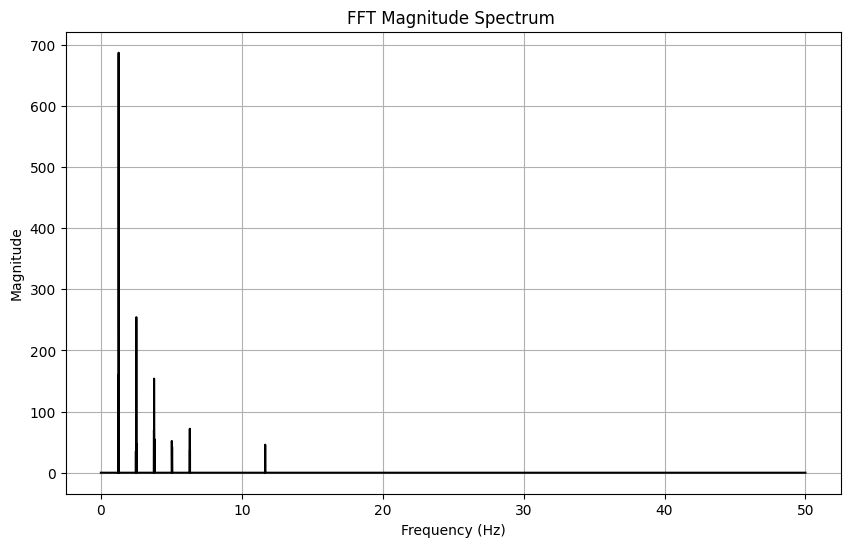

In [38]:
fourier.plot_fft_results(df_fft, label_filtered, 'k')

In [39]:
fourier.plotly_fft_results(df_fft, label_filtered, 'black')

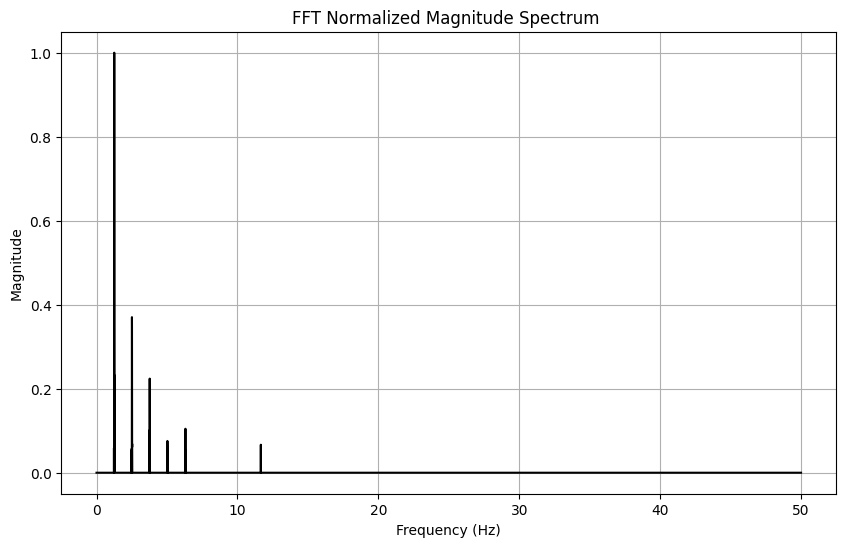

In [40]:
fourier.plot_normalized_fft_results(df_fft, label_filtered,'black')

In [41]:
fourier.plotly_normalized_fft_results(df_fft, label_filtered,'black')

In [42]:
spectrum, frequencies = wavelet.calculate_cwt(df_filtered, label_filtered, wavelet_function, lowcut, highcut)

In [43]:
gif_name = "wavelet_spectrum.gif"
file_location_gif = utils.get_results_files_location(gif_name)

In [44]:
wavelet.spectrum(df_filtered, label_filtered, wavelet_function, lowcut, highcut, save_gif=True, file_location=file_location_gif, magnitude_type=magnitude_type, magnitude_factor=magnitude_factor)

C:\Users\ingah\estructuraPy\signalepy\src\signalepy\wavelet.py:285: UserWarning:

An error occurred during wavelet spectrum processing: plot_interactive_wavelet_spectrum() got an unexpected keyword argument 'elevation'



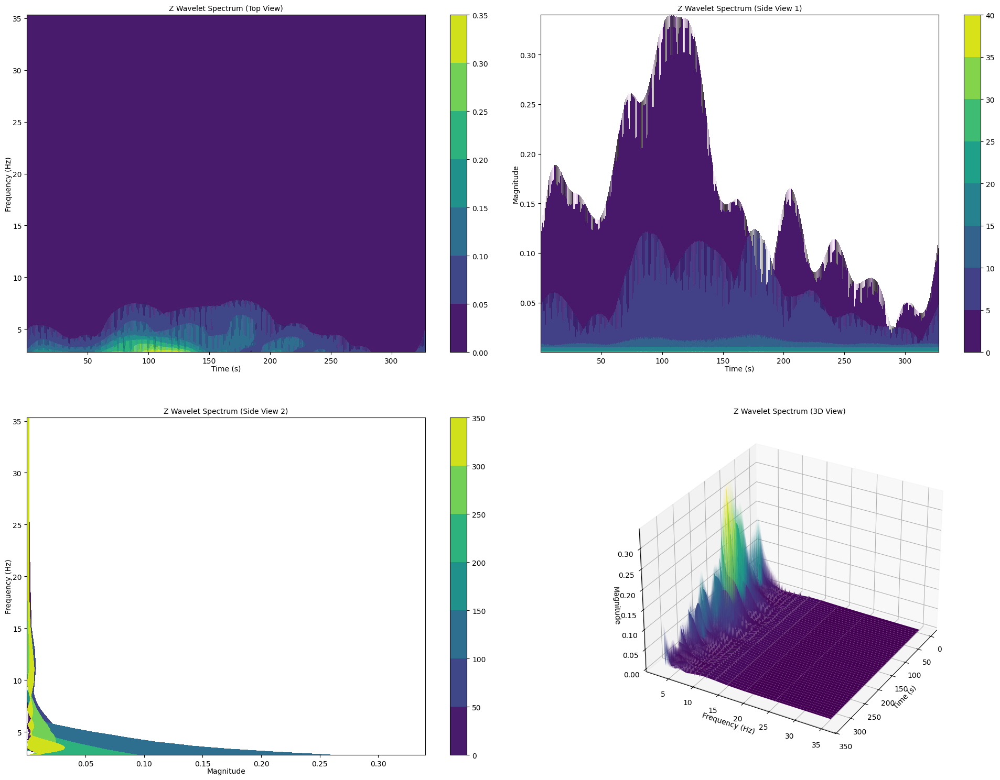

In [45]:
wavelet.plot_spectrum_views(df_filtered, spectrum, frequencies, label)

In [46]:
wavelet.plotly_spectrum_views(df_filtered, spectrum, frequencies, label)

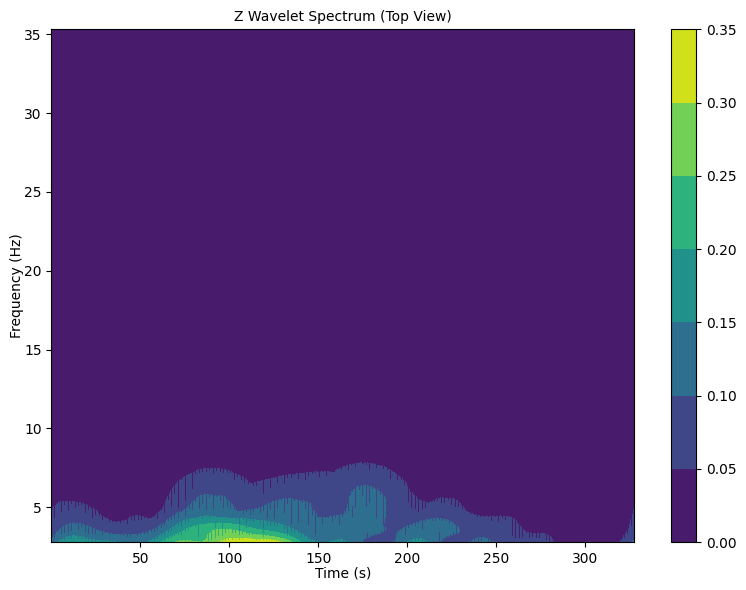

In [48]:
wavelet.plot_spectrum_time_frequency(df_filtered, spectrum, frequencies, label)

In [ ]:
wavelet.plotly_spectrum_time_frequency(df_filtered, spectrum, frequencies, label)

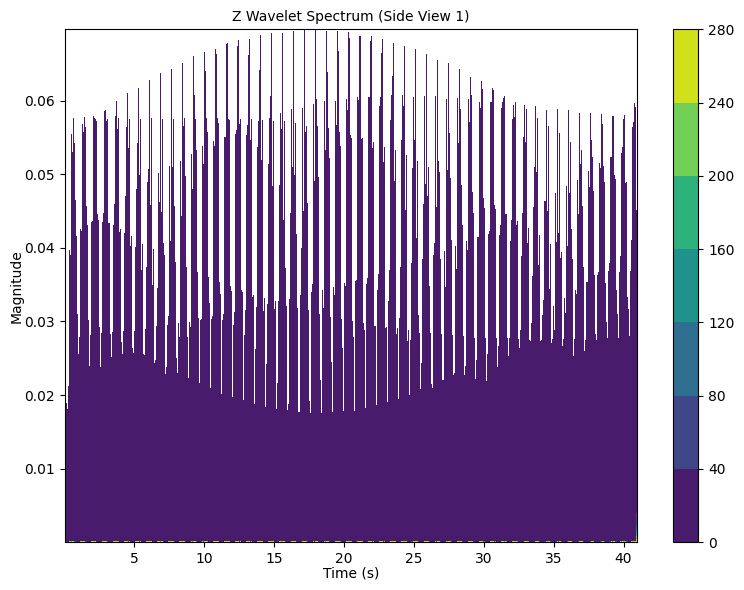

In [ ]:
plot.wavelet_spectrum_time_magnitude(df_filtered, spectrum, frequencies, label)

In [ ]:
wavelet.plotly_spectrum_time_magnitude(df_filtered, spectrum, frequencies, label)